In [1]:
from neo import io
import neo
import numpy as np
from pathlib import Path
import matplotlib.pylab as plt 
import seaborn as sns
import pandas as pd
from pathlib import Path
from utils import *
from utils_analysis import *
from utils_spectral import *
from utils_BK_corr import *

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils_spectral.py:4: DeprecationWarning: 
The `fooof` package is being deprecated and replaced by the `specparam` (spectral parameterization) package.
This version of `fooof` (1.1) is fully functional, but will not be further updated.
New projects are recommended to update to using `specparam` (see Changelog for details).
  from fooof import FOOOF


In [2]:
# useful for plotting
sns.set_theme(style="dark")
sns.set_context("notebook")
plt.style.use('ggplot')
plt.rcParams['font.family'] = 'DejaVu Serif'
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['font.size'] = 8
plt.rcParams['axes.titlesize'] = 8
plt.rcParams['axes.labelsize'] = 6
plt.rcParams['figure.labelsize'] = 6
plt.rcParams['legend.fontsize'] = 6
plt.rcParams['figure.titlesize'] = 10
plt.rcParams['xtick.labelsize'] = 6
plt.rcParams['ytick.labelsize'] = 6
plt.rcParams['figure.figsize'] = (8.27, 6)

In [5]:
# loading the data
# spike_rows = []

# for file in Path("/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/results_1.000/basal_activity").glob("*.nio"):
#     print(f"Leggo: {file.name}")
#     reader = neo.io.NixIO(filename=str(file), mode="ro")
#     block = reader.read_block()

#     for seg_idx, segment in enumerate(block.segments):
#        for st_idx, spiketrain in enumerate(segment.spiketrains):
#            spike_times = spiketrain.times.rescale("ms").magnitude
#             senders = spiketrain.annotations.get("senders", None)
#             device = spiketrain.annotations.get("device", "unknown")
#             pop_size = spiketrain.annotations.get("pop_size", None)

#             if senders and len(senders) == len(spike_times):
#                 for time, sender in zip(spike_times, senders):
#                     spike_rows.append({
#                         "time_ms": time,
#                         "sender_id": sender,
#                         "pop": device.split('_')[0],
#                         "segment": seg_idx,
#                         "file": file.name
#                     })
#             else:
#                 for time in spike_times:
#                     spike_rows.append({
#                         "time_ms": time,
#                         "sender_id": f"unit{st_idx}",
#                         "pop": device.split('_')[0],
#                         "segment": seg_idx,
#                         "file": file.name
#                     })

# df_spikes = pd.DataFrame(spike_rows)
# print("Pops:", df_spikes['pop'].unique())

In [3]:
df_spikes = pd.read_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/pc_spikes.csv')

Shape: (86590, 2)
[[4.90000e+00 3.31240e+04]
 [6.20000e+00 3.31540e+04]
 [1.86000e+01 3.31240e+04]
 ...
 [2.49696e+04 3.31100e+04]
 [2.49866e+04 3.31400e+04]
 [2.49885e+04 3.31100e+04]]
Computing firing rates of purkinje
Number of neurons: 68
Time vector: 0 25000.4
Number of bins: 5001
Kernel size: 8
Neuron ID: 33097.0
First few spikes: [ 8.5 27.9 52.  76.  97.7]
Neuron ID: 33098.0
First few spikes: [ 9.1 27.7 50.9 71.2 91. ]
Neuron ID: 33099.0
First few spikes: [ 6.1 22.7 42.3 66.1 86. ]
Rates array shape: (68, 5001)
Rates array first few values: [[31.25 43.75 50.   ... 18.75  6.25  0.  ]
 [31.25 43.75 50.   ... 50.   50.   43.75]
 [31.25 50.   62.5  ... 31.25 18.75  6.25]
 [18.75 31.25 50.   ... 31.25 18.75  6.25]
 [31.25 43.75 50.   ... 31.25 18.75  6.25]]
Rates array first few neurons: [[31.25 43.75 50.   50.   50.  ]
 [31.25 43.75 50.   50.   50.  ]
 [31.25 50.   62.5  62.5  62.5 ]
 [18.75 31.25 50.   62.5  62.5 ]
 [31.25 43.75 50.   50.   50.  ]
 [31.25 43.75 50.   50.   50.  ]
 

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


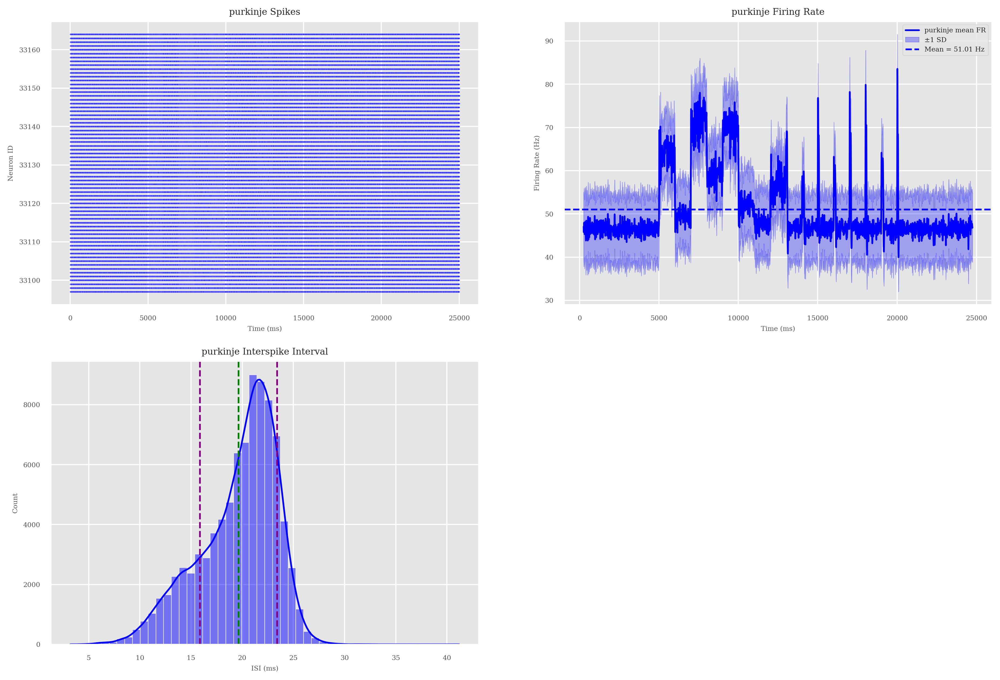

In [4]:
times_vectorPC, mean_ratePC, rates_per_neuronPC, stats_popPC, isi_dictPC, stats_dictPC, df_spikes = process_pop(df_spikes, "purkinje", color="blue", mask_flag=True, dt=5, sigma=20)

In [8]:
rates_per_neuronPC[0].shape

(4901,)

In [6]:
df_spikes.shape

(86590, 2)

Coefficient of Variation: 0.1057
Mean ISI: 21.4979 +- 2.2713 ms
Min ISI: 5.9000 ms, Max ISI: 29.9000 ms
Duration of the interval: 5000 ms
Spikes in interval: 15823
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 46.4721+/-1.1647
Max firing rate: 50.0000
Min firing rate: 43.4743
------------------------------------------------------------
📊 Statistics of Interspike intervals for population Purkinje Cells:
Mean ISI: 21.4979 +- 2.2713 ms
Min ISI: 5.9000 ms, Max ISI: 29.9000 ms
Coefficient of Variation: 0.1057


/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


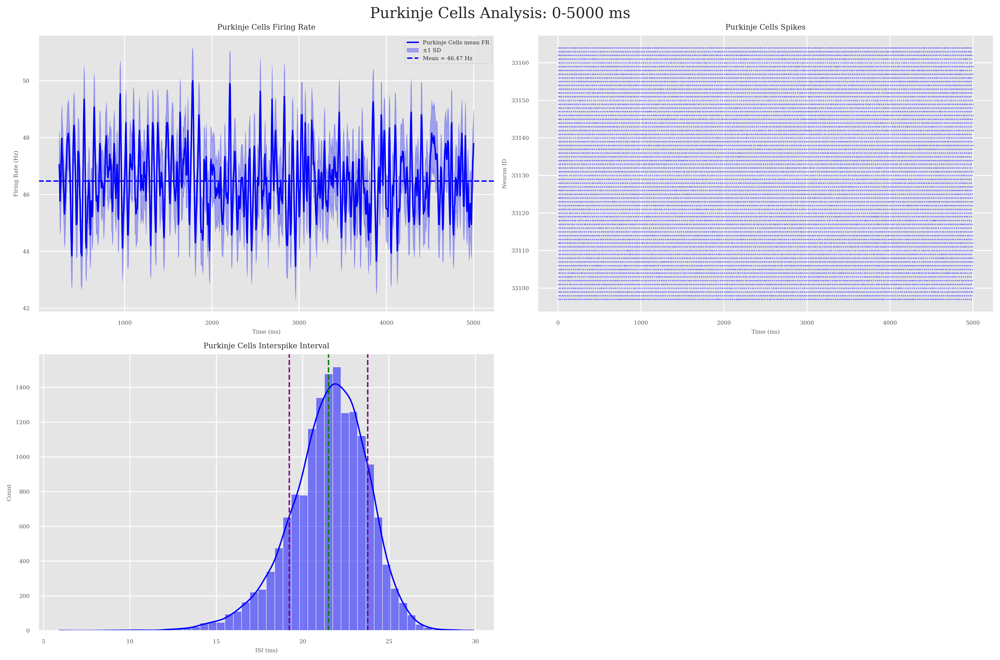

In [7]:
rates_per_neuronPC_baseline1, time_mask_baseline1, interval_spikes, isi_dict, isi_stats = extract_fr(
    spiking_data=df_spikes,
    times_vector=times_vectorPC,
    rates_per_neuron=rates_per_neuronPC,
    mean_rate=mean_ratePC,
    time_interval=(0, 5000),
    pop='Purkinje Cells',
    color='blue',
    plot=True
)


Coefficient of Variation: 0.1035
Mean ISI: 21.4813 +- 2.2225 ms
Min ISI: 9.8000 ms, Max ISI: 29.1000 ms
Duration of the interval: 4800.0 ms
Spikes in interval: 15194
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 46.5590+/-1.1999
Max firing rate: 50.0919
Min firing rate: 41.8199
------------------------------------------------------------
📊 Statistics of Interspike intervals for population Purkinje Cells:
Mean ISI: 21.4813 +- 2.2225 ms
Min ISI: 9.8000 ms, Max ISI: 29.1000 ms
Coefficient of Variation: 0.1035


/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


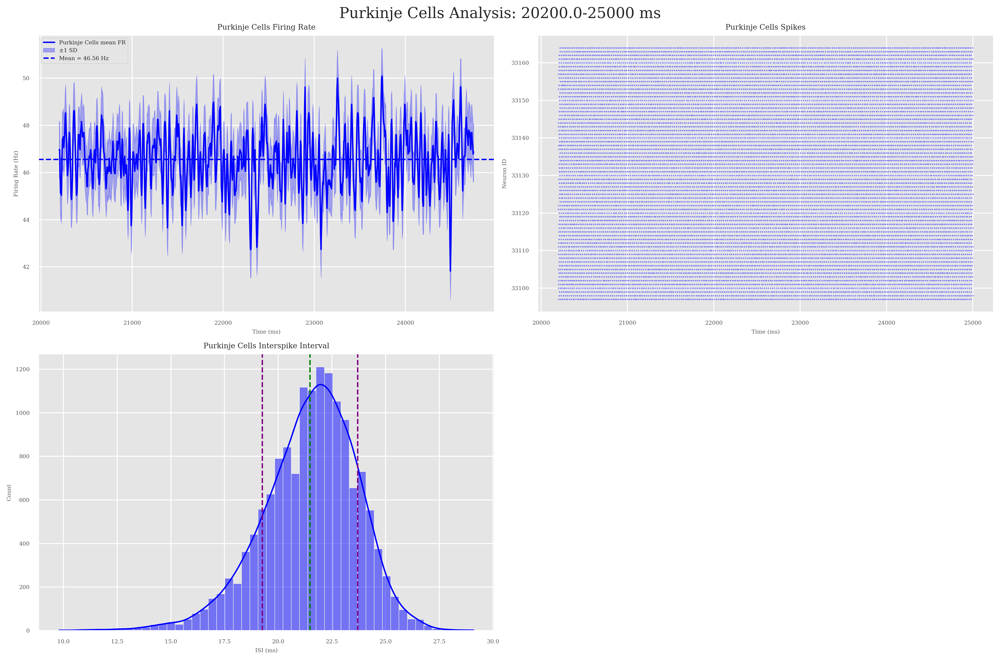

In [16]:
rates_per_neuronPC_baseline2, time_mask_baseline2, interval_spikes, isi_dict, isi_stats = extract_fr(
    spiking_data=df_spikes,
    times_vector=times_vectorPC,
    rates_per_neuron=rates_per_neuronPC,
    mean_rate=mean_ratePC,
    time_interval=(20200.0, 25000),
    pop='Purkinje Cells',
    color='blue',
    plot=True
)


Shape of baseline rates per neuron for Purkinje Cells: (1882,)
Mean firing rate for Purkinje Cells in baseline: (1882,)
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 46.5130+/-1.1881
Max firing rate: 50.0919
Min firing rate: 41.0846


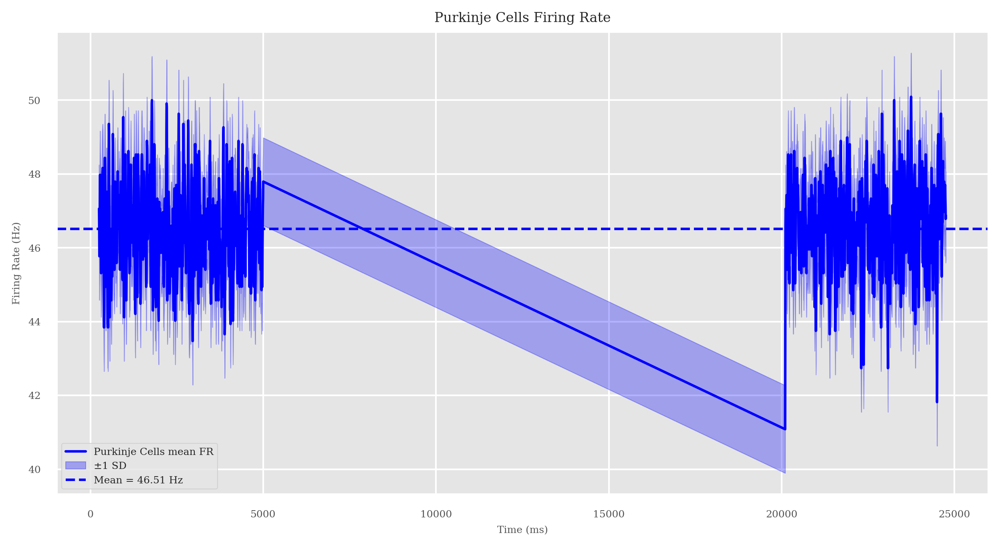

In [9]:
baseline_rates_per_neuronPC = np.hstack((rates_per_neuronPC_baseline1, rates_per_neuronPC_baseline2))
time_mask_b= np.hstack((time_mask_baseline1, time_mask_baseline2))
time_vector_b = np.hstack((times_vectorPC[time_mask_baseline1], times_vectorPC[time_mask_baseline2]))

print("Shape of baseline rates per neuron for Purkinje Cells:", time_vector_b.shape)
mean_ratePC_baseline = np.mean(baseline_rates_per_neuronPC, axis=0)
print("Mean firing rate for Purkinje Cells in baseline:", mean_ratePC_baseline.shape)
fig, ax = plt.subplots(figsize=(10, 5))
plot_firing_rate(time_vector_b, mean_ratePC_baseline, ax=ax, pop='Purkinje Cells', color='blue')

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils_analysis.py:41: FutureWarning: The behavior of obj[i:j] with a float-dtype index is deprecated. In a future version, this will be treated as positional instead of label-based. For label-based slicing, use obj.loc[i:j] instead
  sns.heatmap(heatmap_data.T[:100], ax=ax, cmap='plasma', cbar_kws={'label': 'Counts Frequencies'})


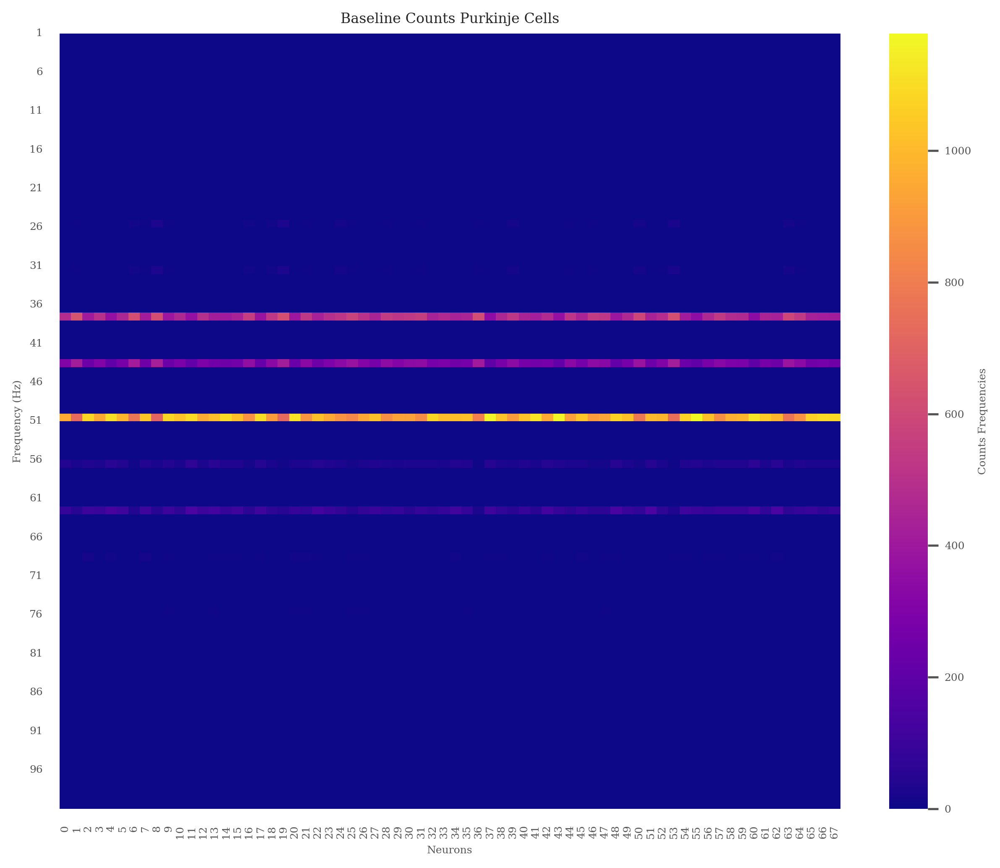

In [14]:
heatmap_baseline = heatmap_firing_rates(baseline_rates_per_neuronPC)
plot_count_heatmap(heatmap_baseline, title='Baseline Counts Purkinje Cells')

In [15]:
print(f"Number of zero entries in baseline2_heatmap: {(heatmap_baseline == 0).sum().sum()}")
print(f"Number of total entries in baseline2_heatmap: {heatmap_baseline.size}\n")

Number of zero entries in baseline2_heatmap: 12970
Number of total entries in baseline2_heatmap: 13532



PCA explained variance ratio: [0.96228531 0.03309965]
PCA Summary:
PC1 explains 96.2% of variance
PC2 explains 3.3% of variance


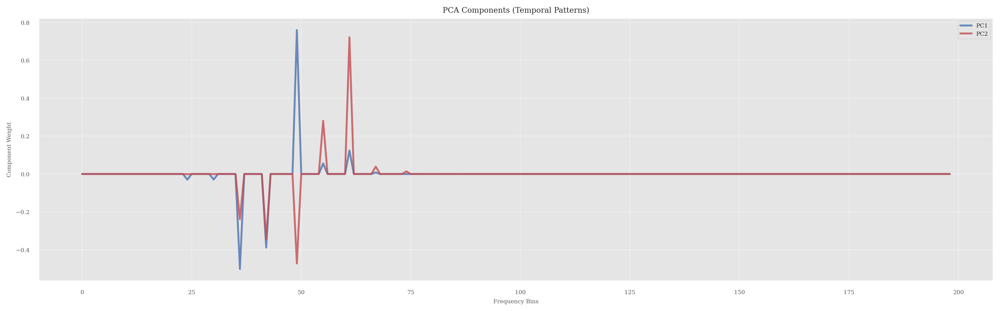

In [ ]:
heatmap_pca, pca_obj = PCA_heatmap(heatmap_baseline, n_components=2)

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils_analysis.py:41: FutureWarning: The behavior of obj[i:j] with a float-dtype index is deprecated. In a future version, this will be treated as positional instead of label-based. For label-based slicing, use obj.loc[i:j] instead
  sns.heatmap(heatmap_data.T[:100], ax=ax, cmap='plasma', cbar_kws={'label': 'Counts Frequencies'})


PCA Summary:
PC1 explains 96.2% of variance
PC2 explains 3.3% of variance


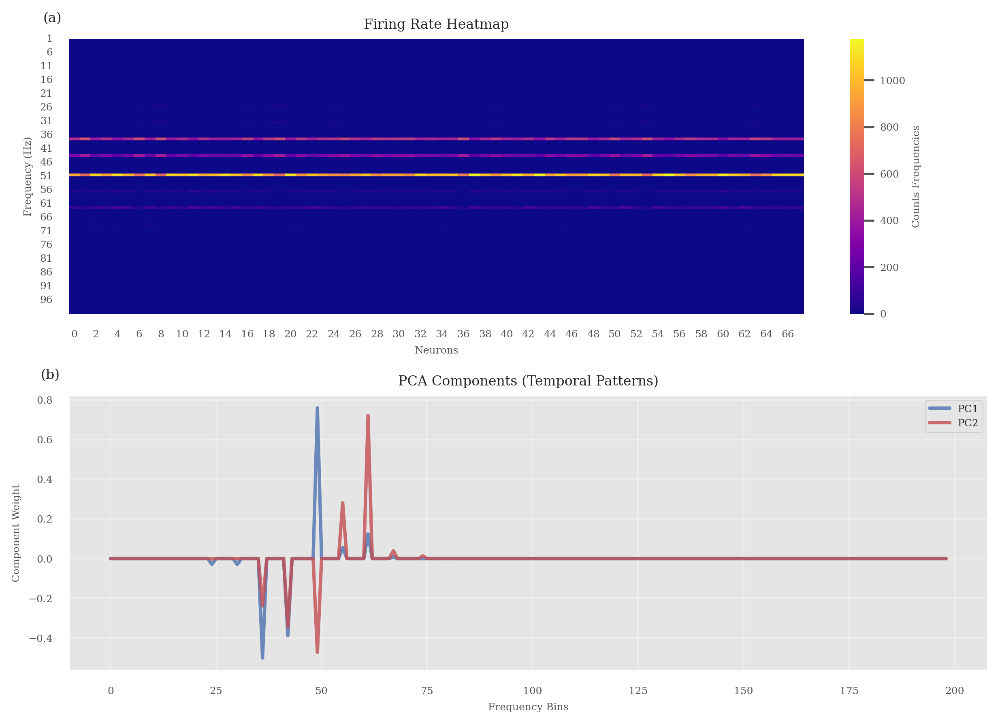

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1)

plot_count_heatmap(heatmap_baseline, ax=ax1)
ax1.text(-0.01, 1.05, '(a)', transform=ax1.transAxes, va='bottom', ha='right')

plot_pca_analysis(heatmap_baseline, pca_obj, ax=ax2)
ax2.text(-0.01, 1.05, '(b)', transform=ax2.transAxes, va='bottom', ha='right')
plt.tight_layout()

In [18]:
labels_baseline = kmeans_cluster(heatmap_pca, n_clusters=2)

K-Means Clustering: 2 clusters
Silhouette Coefficient: 0.577


First 5 neurons (sorted by Cell ID):
   Cell_ID  Frequency Label  Original_Index
0        1  46.443278    ON               0
1        2  44.673220   OFF               1
2        3  47.492694    ON               2
3        4  46.466525    ON               3
4        5  48.077179    ON               4


/home/nix/miniconda3/envs/pytorch_env/lib/python3.12/site-packages/seaborn/categorical.py:700: PendingDeprecationWarning: vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.
  artists = ax.bxp(**boxplot_kws)
/home/nix/miniconda3/envs/pytorch_env/lib/python3.12/site-packages/seaborn/categorical.py:700: PendingDeprecationWarning: vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.
  artists = ax.bxp(**boxplot_kws)


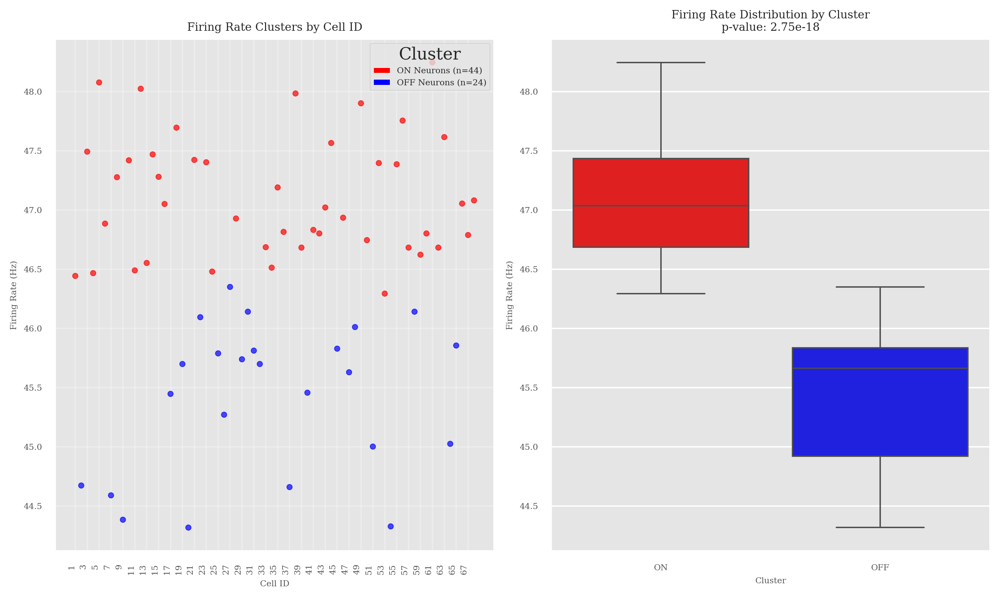

In [19]:
neuronsON, neuronsOFF = plot_fr_clusters(
    rates_per_neuron=baseline_rates_per_neuronPC,
    clusters=labels_baseline
)

First 5 neurons (sorted by Cell ID):
   Cell_ID  Frequency Label  Original_Index
0        1  46.443278    ON               0
1        2  44.673220   OFF               1
2        3  47.492694    ON               2
3        4  46.466525    ON               3
4        5  48.077179    ON               4
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 46.5130+/-1.1881
Max firing rate: 50.0919
Min firing rate: 41.0846


/home/nix/miniconda3/envs/pytorch_env/lib/python3.12/site-packages/seaborn/categorical.py:700: PendingDeprecationWarning: vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.
  artists = ax.bxp(**boxplot_kws)
/home/nix/miniconda3/envs/pytorch_env/lib/python3.12/site-packages/seaborn/categorical.py:700: PendingDeprecationWarning: vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.
  artists = ax.bxp(**boxplot_kws)
/tmp/ipykernel_25640/709881179.py:28: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


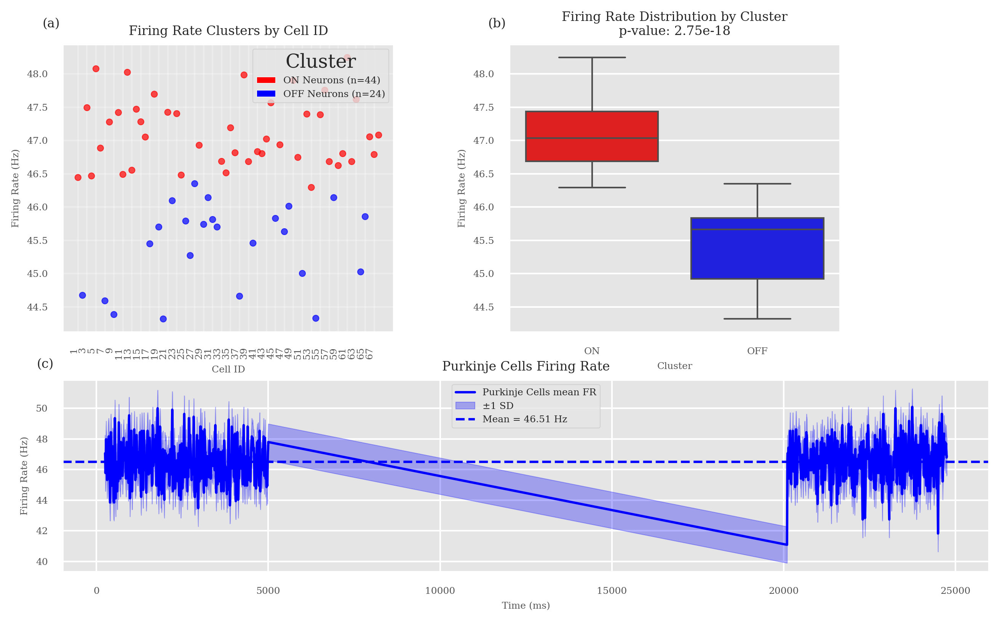

In [ ]:
from matplotlib.gridspec import GridSpec
fig = plt.figure()
gs = GridSpec(2, 3, figure=fig,
              height_ratios=[1.5, 1], 
              width_ratios=[1, 1, 0.1],
              hspace=0.2, wspace=0.5, left=0.01, right=0.99) 

ax1_left = fig.add_subplot(gs[0, 0])
ax1_right = fig.add_subplot(gs[0, 1])

ax2_center = fig.add_subplot(gs[1, 0:3])

plot_fr_clusters(
    rates_per_neuron=baseline_rates_per_neuronPC,
    clusters=labels_baseline,
    ax=[ax1_left, ax1_right]
)
ax1_left.text(-0.01, 1.05, '(a)', transform=ax1_left.transAxes, va='bottom', ha='right')
ax1_right.text(-0.01, 1.05, '(b)', transform=ax1_right.transAxes, va='bottom', ha='right')

plot_firing_rate(time_vector_b, mean_ratePC_baseline, ax=ax2_center, pop='Purkinje Cells', color='blue')
ax2_center.text(-0.01, 1.05, '(c)', transform=ax2_center.transAxes, va='bottom', ha='right')

plt.tight_layout()
plt.show()

Shape: (119955, 2)
[[2.21000e+01 6.40000e+01]
 [2.39000e+01 1.24000e+02]
 [2.42000e+01 4.00000e+00]
 ...
 [2.49959e+04 8.00000e+01]
 [2.49960e+04 5.00000e+01]
 [2.49981e+04 1.10000e+02]]
Computing firing rates of basket
Number of neurons: 150
Time vector: 0 25000.9
Number of bins: 5001
Kernel size: 8
Neuron ID: 1.0
First few spikes: [ 24.1 253.9 418.1 493.4 566.2]
Neuron ID: 2.0
First few spikes: [ 24.9 418.5 599.5 658.3 748.9]
Neuron ID: 3.0
First few spikes: [ 24.   93.2 185.8 208.4 251.1]
Rates array shape: (150, 5001)
Rates array first few values: [[ 0.    6.25 18.75 ...  0.    0.    0.  ]
 [ 0.    6.25 18.75 ...  0.    0.    0.  ]
 [ 0.    6.25 18.75 ... 31.25 43.75 43.75]
 [ 0.    6.25 18.75 ... 43.75 43.75 31.25]
 [ 0.    6.25 18.75 ...  0.    0.    0.  ]]
Rates array first few neurons: [[ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.7

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:242: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


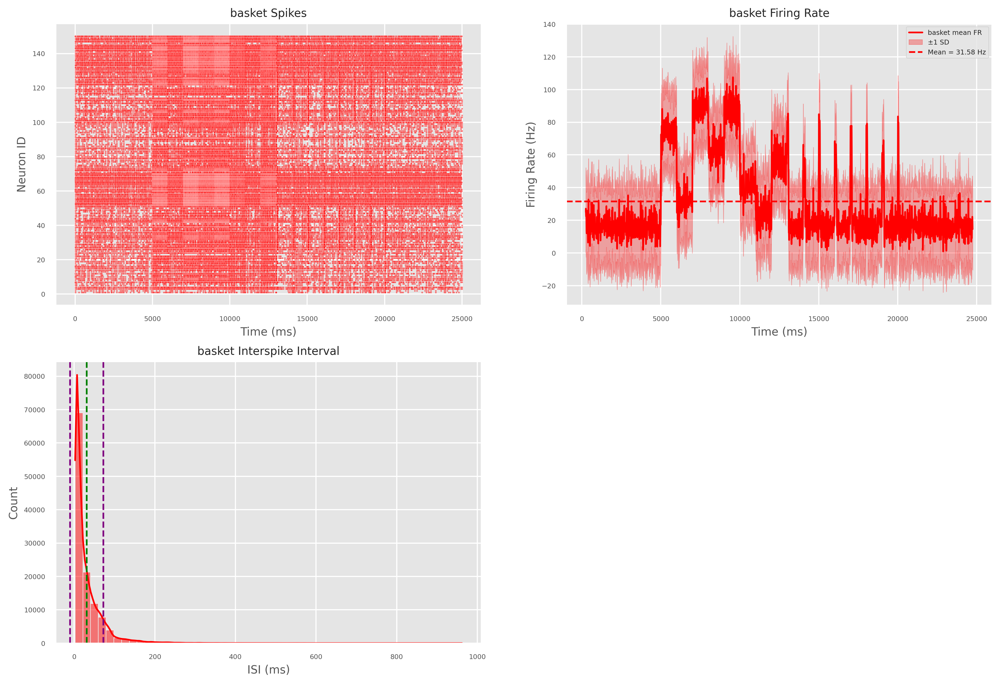

In [12]:
times_vectorBK, mean_rateBK, rates_per_neuronBK, stats_popBK, isi_dictBK, stats_dictBK = process_pop(df_spikes, "basket", color="red", mask_flag=True, dt=5, sigma=20)

Duration of the interval: 5000 ms
------------------------------------------------------------
📊 Statistics for population Basket Cells:
Mean firing rate: 16.1300+/-5.5833
Max firing rate: 35.2500
Min firing rate: 1.8750
Duration of the interval: 4900.0 ms
------------------------------------------------------------
📊 Statistics for population Basket Cells:
Mean firing rate: 16.3683+/-5.6385
Max firing rate: 36.6250
Min firing rate: 0.9167


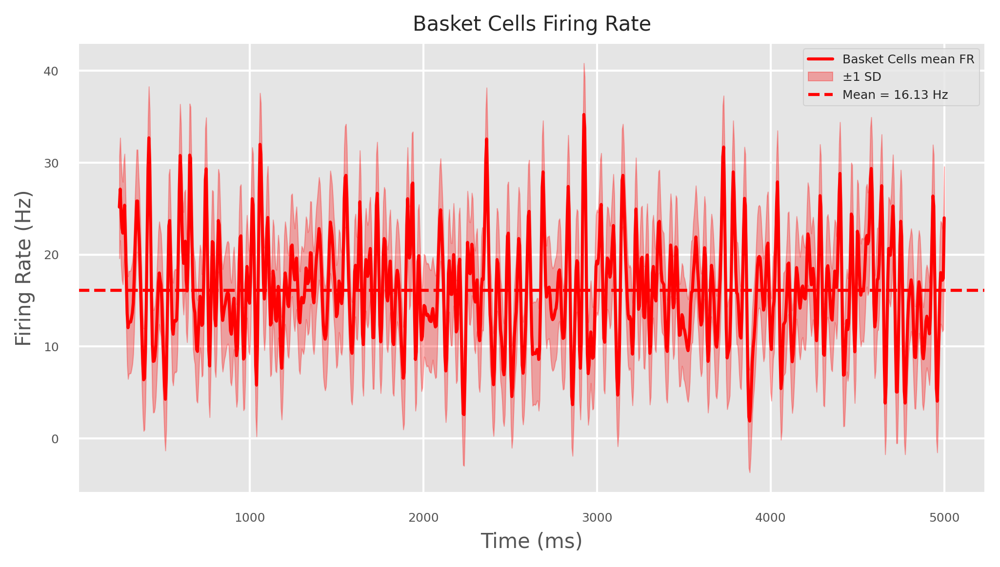

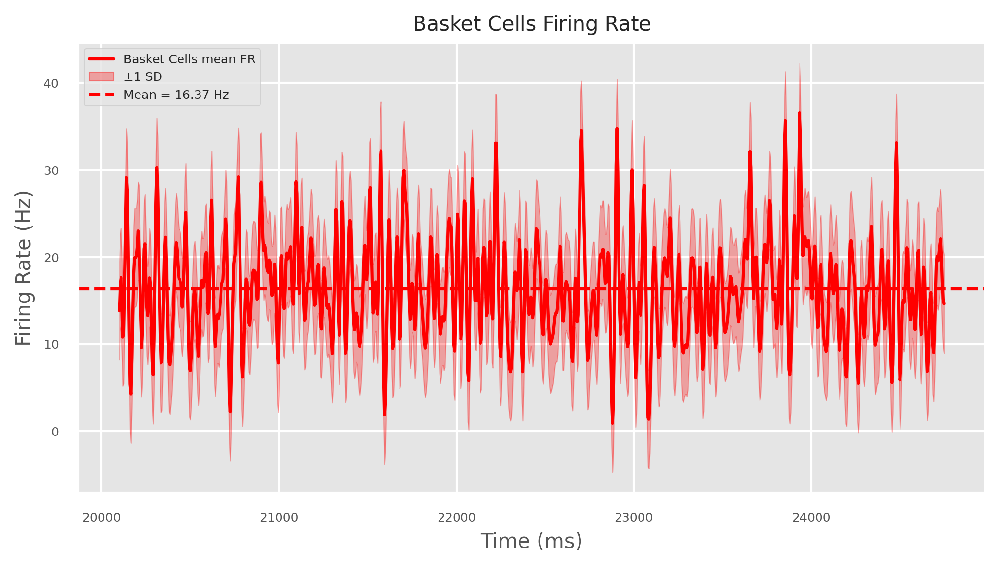

In [13]:
baseline1_rates_per_neuronBK, time_mask_baseline1 = extract_fr(times_vectorBK, rates_per_neuronBK, mean_rateBK, time_interval=(0, 5000), pop='Basket Cells', color='red', plot=True)
baseline2_rates_per_neuronBK, time_mask_baseline2 = extract_fr(times_vectorBK, rates_per_neuronBK, mean_rateBK, time_interval=(20100.0, 25000), pop='Basket Cells', color='red', plot=True)

Shape of baseline rates per neuron for Basket Cells: (1882,)
Mean firing rate for Basket Cells in baseline: (1882,)
------------------------------------------------------------
📊 Statistics for population Basket Cells:
Mean firing rate: 16.2479+/-5.6119
Max firing rate: 36.6250
Min firing rate: 0.9167


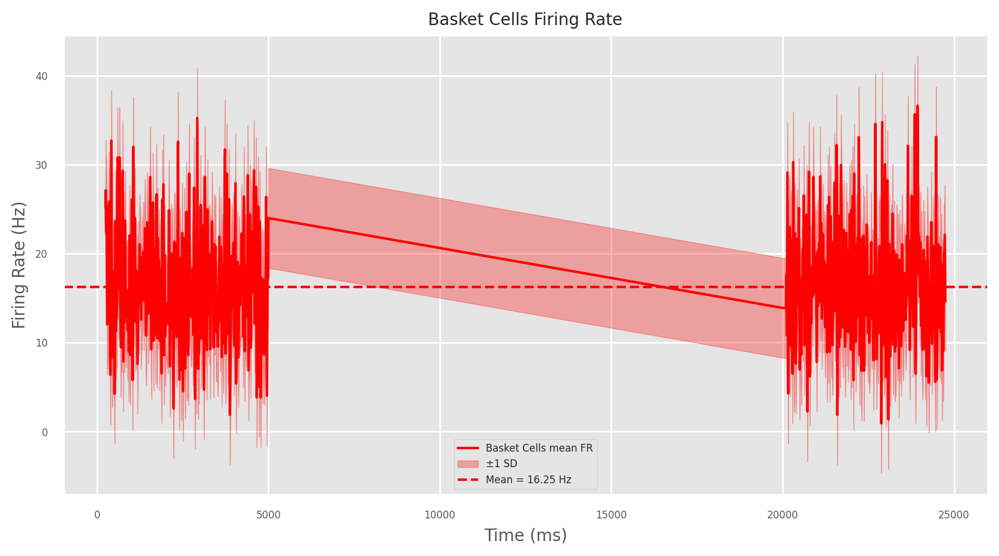

In [14]:
baseline_rates_per_neuronBK = np.hstack((baseline1_rates_per_neuronBK, baseline2_rates_per_neuronBK))
time_mask_b= np.hstack((time_mask_baseline1, time_mask_baseline2))
time_vector_b = np.hstack((times_vectorBK[time_mask_baseline1], times_vectorBK[time_mask_baseline2]))

print("Shape of baseline rates per neuron for Basket Cells:", time_vector_b.shape)
mean_rateBK_baseline = np.mean(baseline_rates_per_neuronBK, axis=0)
print("Mean firing rate for Basket Cells in baseline:", mean_rateBK_baseline.shape)
fig, ax = plt.subplots(figsize=(10, 5))
plot_firing_rate(time_vector_b, mean_rateBK_baseline, ax=ax, pop='Basket Cells', color='red')

Shape: (202864, 2)
[[8.00000e+00 3.34540e+04]
 [2.35000e+01 3.33040e+04]
 [2.37000e+01 3.33340e+04]
 ...
 [2.49941e+04 3.33800e+04]
 [2.49960e+04 3.32000e+04]
 [2.49999e+04 3.34100e+04]]
Computing firing rates of stellate
Number of neurons: 300
Time vector: 0 25000.9
Number of bins: 5001
Kernel size: 8
Neuron ID: 33165.0
First few spikes: [ 23.7  86.7 143.4 171.2 201.3]
Neuron ID: 33166.0
First few spikes: [ 23.8  85.1 139.3 180.5 208.1]
Neuron ID: 33167.0
First few spikes: [ 24.2 259.6 321.1 478.2 539.5]
Rates array shape: (300, 5001)
Rates array first few values: [[ 0.    6.25 18.75 ... 62.5  50.   31.25]
 [ 0.    6.25 18.75 ... 43.75 43.75 31.25]
 [ 0.    6.25 18.75 ...  0.    0.    0.  ]
 [ 0.    6.25 18.75 ... 43.75 43.75 31.25]
 [ 0.    6.25 18.75 ...  0.    0.    0.  ]]
Rates array first few neurons: [[ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.75]
 ...
 [ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.25 18.75 31.25 43.75]
 [ 0.    6.

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:242: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


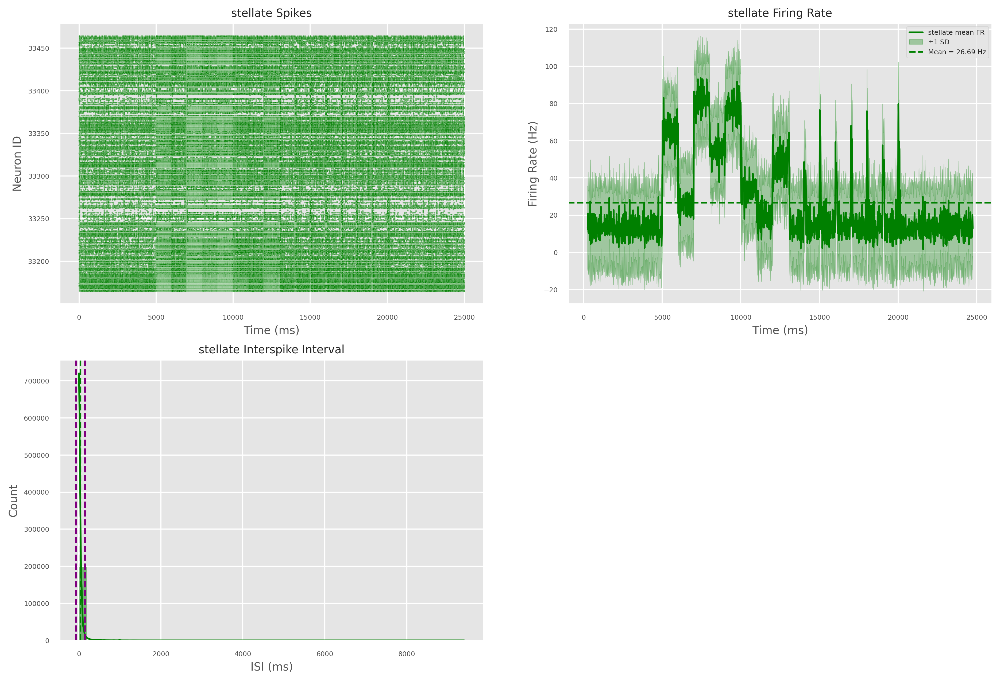

In [15]:
times_vectorST, mean_rateST, rates_per_neuronST, stats_popST, isi_dictST, stats_dictST = process_pop(df_spikes, "stellate", color="green", mask_flag=True, dt=5, sigma=20)

Duration of the interval: 5000 ms
------------------------------------------------------------
📊 Statistics for population Stellate Cells:
Mean firing rate: 12.8755+/-4.4626
Max firing rate: 29.7500
Min firing rate: 2.3750
Duration of the interval: 4900.0 ms
------------------------------------------------------------
📊 Statistics for population Stellate Cells:
Mean firing rate: 13.4064+/-4.4101
Max firing rate: 33.3958
Min firing rate: 1.6042


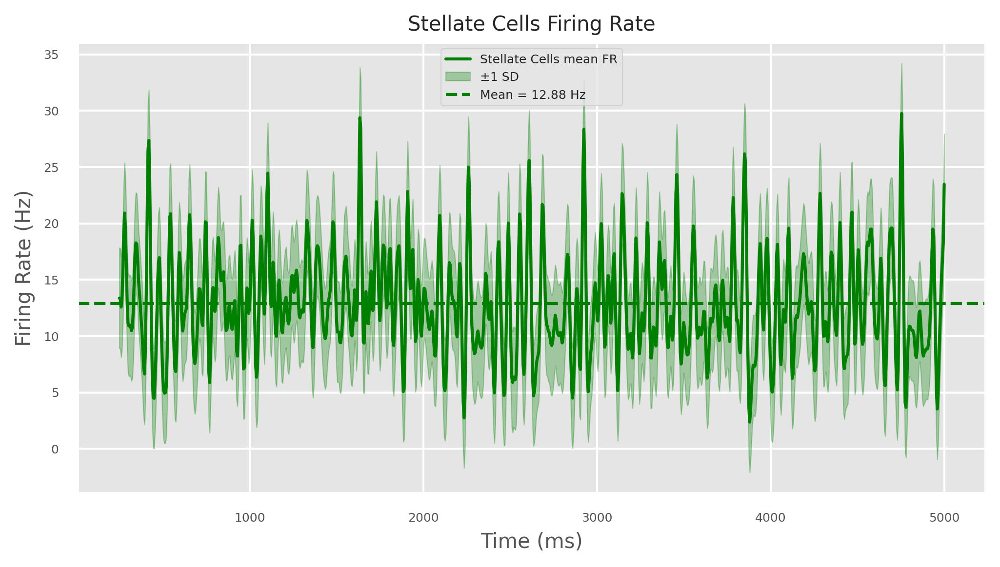

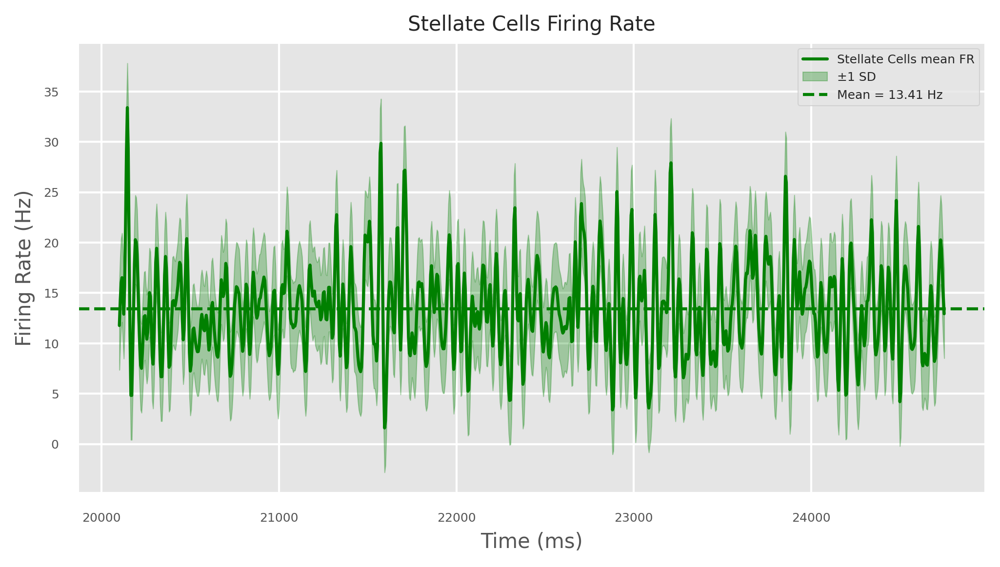

In [16]:
baseline1_rates_per_neuronST, time_mask_baseline1ST = extract_fr(times_vectorST, rates_per_neuronST, mean_rateST, time_interval=(0, 5000), pop='Stellate Cells', color='green', plot=True)
baseline2_rates_per_neuronST, time_mask_baseline2ST = extract_fr(times_vectorST, rates_per_neuronST, mean_rateST, time_interval=(20100.0, 25000), pop='Stellate Cells', color='green', plot=True)

Shape of baseline rates per neuron for Stellate Cells: (1882,)
Mean firing rate for Stellate Cells in baseline: (1882,)
------------------------------------------------------------
📊 Statistics for population Stellate Cells:
Mean firing rate: 13.1381+/-4.4446
Max firing rate: 33.3958
Min firing rate: 1.6042


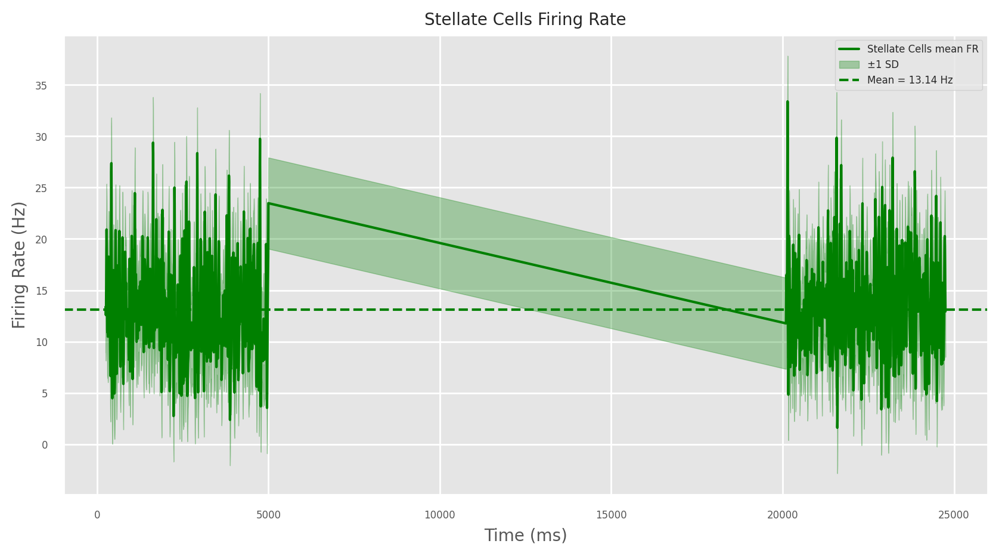

In [17]:
baseline_rates_per_neuronST = np.hstack((baseline1_rates_per_neuronST, baseline2_rates_per_neuronST))
time_mask_b= np.hstack((time_mask_baseline1ST, time_mask_baseline2ST))
time_vector_b = np.hstack((times_vectorST[time_mask_baseline1ST], times_vectorST[time_mask_baseline2ST]))

print("Shape of baseline rates per neuron for Stellate Cells:", time_vector_b.shape)
mean_rateST_baseline = np.mean(baseline_rates_per_neuronST, axis=0)
print("Mean firing rate for Stellate Cells in baseline:", mean_rateST_baseline.shape)
fig, ax = plt.subplots(figsize=(10, 5))
plot_firing_rate(time_vector_b, mean_rateST_baseline, ax=ax, pop='Stellate Cells', color='green')

In [18]:
# MLI rates
baseline_rates_per_neuronST.shape, baseline_rates_per_neuronBK.shape, baseline_rates_per_neuronPC.shape

((300, 1882), (150, 1882), (68, 1882))

In [19]:
baseline_rates_per_neuronMLI = np.vstack((baseline_rates_per_neuronST, baseline_rates_per_neuronBK))
print("Shape of baseline rates per neuron for MLI:", baseline_rates_per_neuronMLI.shape)

Shape of baseline rates per neuron for MLI: (450, 1882)


In [ ]:
def plot_power_spectrum(freqs, psd, pop, n_neurons_to_plot=8, log_plot=False):
    """
    Plot power spectrum for a given population.
    
    Args:
        freqs: frequencies corresponding to the power spectrum
        psd: power spectral density values (shape: n_neurons x n_freqs)
        pop: name of the population
        n_neurons_to_plot: number of neurons to plot
        log_plot: if True, shows linear, log-y, and log-log plots
    """
    range_mask = (freqs >= 50) & (freqs <= 100)
    neurons_max_in_range = np.argsort(np.sum(psd[:, range_mask], axis=1))[-n_neurons_to_plot:]
    colors_neurons = dict(zip(neurons_max_in_range, sns.color_palette('hsv', n_colors=len(neurons_max_in_range))))
    colors = [colors_neurons[i] for i in neurons_max_in_range]
    
    if log_plot:
        fig, axs = plt.subplots(1, 3, figsize=(20, 5), dpi=300)
        plot_titles = [
            f'Linear Power Spectrum for {pop}',
            f'Log-Y Power Spectrum for {pop}', 
            f'Log-Log Power Spectrum for {pop}'
        ]
    else:
        fig, axs = plt.subplots(1, 1, figsize=(15, 5), dpi=300)
        axs = [axs]
        plot_titles = [f'Power Spectrum for {pop}']
    
    for i in range(n_neurons_to_plot):
        neuron_id = neurons_max_in_range[i]
        color = colors[i]
        label = f'Neuron {neuron_id}'
        
        if log_plot:
            axs[0].plot(freqs, psd[neuron_id], label=label, alpha=0.7, 
                       linewidth=0.5, color=color)
    
            axs[1].plot(freqs, psd[neuron_id], label=label, alpha=0.5, 
                       linewidth=0.5, color=color)
            
            axs[2].plot(freqs, psd[neuron_id], label=label, alpha=0.5, 
                       linewidth=0.5, color=color)
        else:
            axs[0].plot(freqs, psd[neuron_id], label=label, alpha=0.7, 
                       linewidth=0.5, color=color)

    for idx, ax in enumerate(axs):
        ax.set_xlabel('Frequency (Hz)')
        ax.set_title(plot_titles[idx])
        ax.axvline(x=50, color='k', linestyle='--', alpha=0.5)
        ax.axvline(x=100, color='k', linestyle='--', alpha=0.5)
        ax.grid(True, alpha=0.3)
        ax.set_xlim(8, 150)
        
        if log_plot:
            if idx == 0:  # Linear plot
                ax.set_ylabel('Power Spectral Density')
            elif idx == 1:  # Log-Y plot
                ax.set_ylabel('Log₁₀(Power Spectral Density)')
                ax.set_yscale('log')
                ax.set_xlim(8, 300)
            elif idx == 2:  # Log-Log plot
                ax.set_ylabel('Log₁₀(Power Spectral Density)')
                ax.set_xscale('log')
                ax.set_yscale('log')
                ax.set_xlim(8, 300) 
                ax.set_ylim(bottom=1e-7)  # Set lower limit for y-axis
        else:
            ax.set_ylabel('Power Spectral Density')

        if n_neurons_to_plot <= 10:
            ax.legend(fontsize=8, loc='upper right')
    
    plt.tight_layout()
    plt.show()

10000.0
Computed power spectrum for 68 neurons with 512 frequency bins.
Frequency range: 9.77 - 5000.00 Hz
PSD shape: (68, 512)


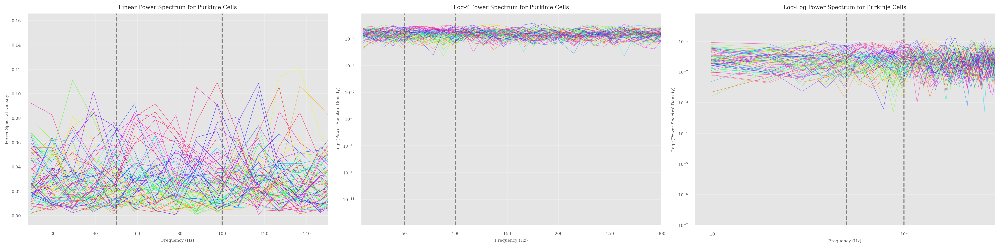

In [15]:
freqs_pc, psd_pc = compute_power_spectrum(baseline_rates_per_neuronPC, dt=0.1, nperseg=1024)

print(f"Frequency range: {freqs_pc[0]:.2f} - {freqs_pc[-1]:.2f} Hz")
print(f"PSD shape: {psd_pc.shape}")
plot_power_spectrum(freqs_pc, psd_pc, 'Purkinje Cells', n_neurons_to_plot=baseline_rates_per_neuronPC.shape[0], log_plot=True)
# plot_log_psd(freqs_pc, psd_pc, n_plot=4)

In [ ]:
psd_df = pd.DataFrame(psd_pc, columns=[f'Freq_{freq:.2f}' for freq in freqs_pc])

# psd_df.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/psdPC_full_baseline.csv', index=False)

10000.0
Computed power spectrum for 450 neurons with 512 frequency bins.
Frequency range: 9.77 - 5000.00 Hz
PSD shape: (450, 512)


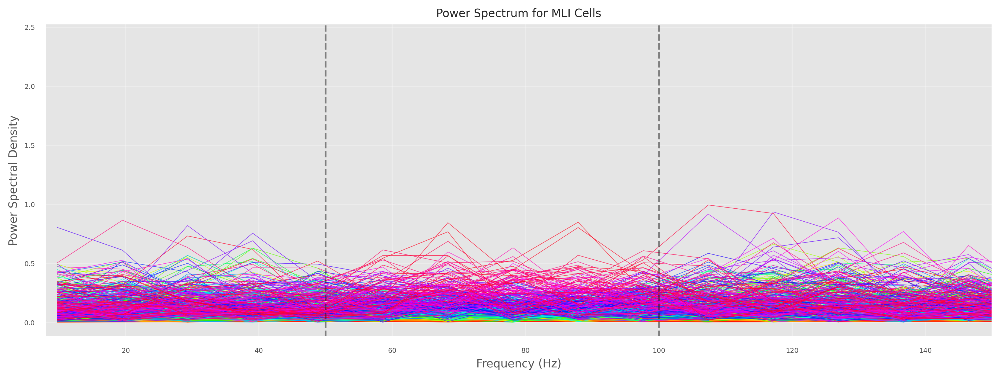

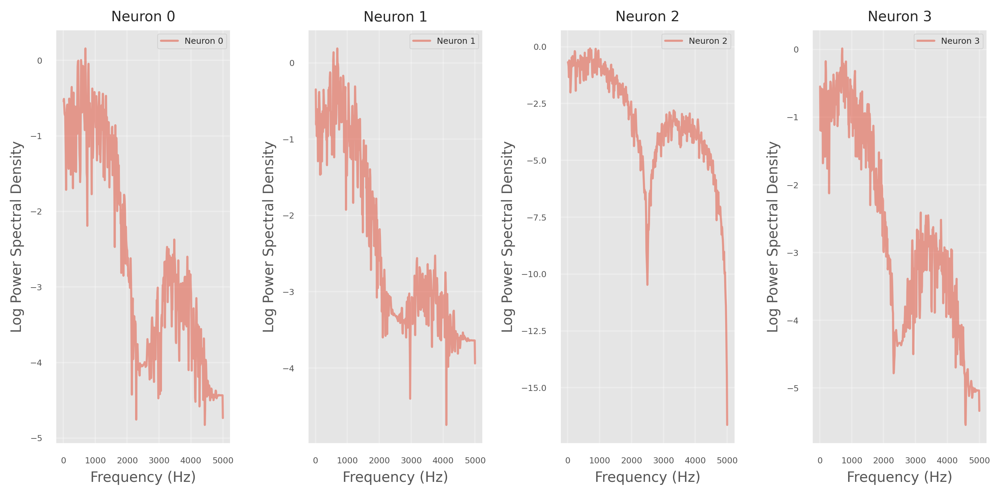

In [ ]:
freqs_MLI, psd_MLI = compute_power_spectrum(baseline_rates_per_neuronMLI, dt=0.1, nperseg=1024)
print(f"Frequency range: {freqs_MLI[0]:.2f} - {freqs_MLI[-1]:.2f} Hz")
print(f"PSD shape: {psd_MLI.shape}")
plot_power_spectrum(freqs_MLI, psd_MLI, 'MLI Cells', n_neurons_to_plot=baseline_rates_per_neuronMLI.shape[0])

In [23]:
# Check for zero frequencies in the power spectrum
# This is to ensure that the power spectrum is computed correctly and does not contain any zero frequencies

np.sum(freqs_pc == 0.0)

np.int64(0)

In [24]:
# veryfying the frequency range and shape of the power spectrum
print(f"Shape of psd_pc: {psd_pc.shape}")
print(f"minimum of freqs_pc: {freqs_pc[0]:.2f} Hz")
print(f"maximum of freqs_pc: {freqs_pc[-1]:.2f} Hz\n")

print(f"Shape of psd_MLI: {psd_MLI.shape}")
print(f"minimum of freqs_MLI: {freqs_MLI[0]:.2f} Hz")
print(f"maximum of freqs_MLI: {freqs_MLI[-1]:.2f} Hz")
print(f"Shape of psd_MLI: {psd_MLI.shape}")

Shape of psd_pc: (68, 512)
minimum of freqs_pc: 9.77 Hz
maximum of freqs_pc: 5000.00 Hz

Shape of psd_MLI: (450, 512)
minimum of freqs_MLI: 9.77 Hz
maximum of freqs_MLI: 5000.00 Hz
Shape of psd_MLI: (450, 512)


Shape of correlation matrix ON: (450, 44)
Shape of correlation matrix OFF: (450, 24)
Shape of combined correlation matrix: (450, 68)
X labels: [1, 6, 8, 16, 18, 19, 21, 24, 25, 26, 28, 29, 30, 31, 36, 39, 44, 46, 47, 50, 53, 57, 63, 64, 0, 2, 3, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15, 17, 20, 22, 23, 27, 32, 33, 34, 35, 37, 38, 40, 41, 42, 43, 45, 48, 49, 51, 52, 54, 55, 56, 58, 59, 60, 61, 62, 65, 66, 67]
Min p-value: 0.0, Max p-value: 0.9999591533209957
Significant p-values (alpha=0.05): 14854 out of 30600


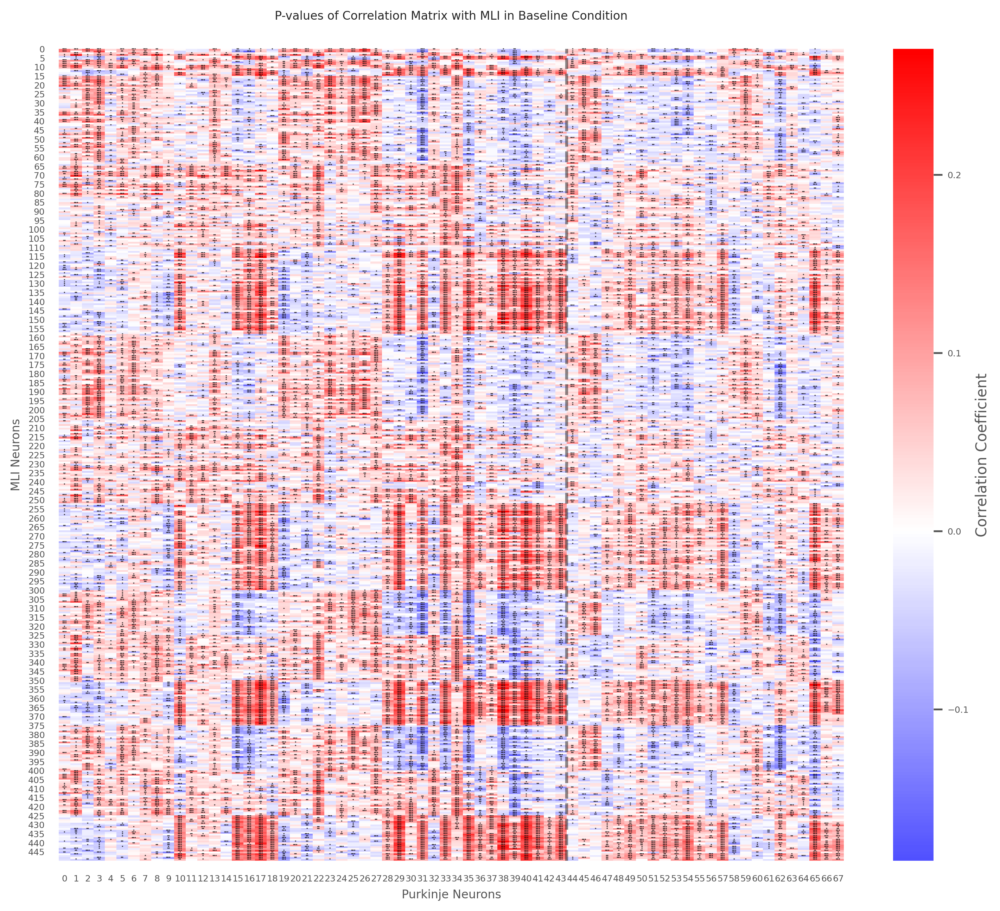

In [25]:
corr_matrixMLIPC, neurons_bound, neuronsON, neuronsOFF = relate_MLI_to_pc(baseline_rates_per_neuronMLI, baseline_rates_per_neuronPC, clusters=labels_baseline)
p_valuesPC = compute_pvalue(corr_matrixMLIPC, dof=baseline_rates_per_neuronMLI.shape[1] - 2)
plot_pvalue_corr(corr_matrixMLIPC, p_valuesPC, neuronsOFF, neuronsON, title='P-values of Correlation Matrix with MLI in Baseline Condition', neurons_boundary=neurons_bound, alpha=0.05)

In [26]:
# foof_features = extract_fooof_features(psd_pc, freqs_pc)

In [27]:
foof_features = pd.read_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/foof_features_baseline12.csv')

In [28]:
foof_features.head()

,Peak1_Freq,Peak1_Power,Peak1_Bandwidth,Aperiodic_Offset,Aperiodic_Exponent,Total_Energy_Entire_PSD,Mean_Phase,Std_Phase,Mean_Firing_Rate,Total_Energy
0,1785.805071,2.105720,29.001421,1.969041,1.827419,5.137805,6.153034,1.964513,46.443278,33.446594
1,2289.017874,2.239553,3000.000000,4.006054,2.686008,4.414709,2.361586,1.840048,44.673220,29.348993
2,1484.001709,2.347297,20.815239,1.681459,1.703779,5.170732,0.037555,2.000181,47.492694,31.811520
3,3682.193282,3.367403,1052.029096,4.526399,3.002476,4.431036,0.015829,1.955101,46.466525,24.607132
4,1670.165070,2.200632,38.820572,2.063714,1.803043,5.367068,0.003894,1.970182,48.077179,28.871596


In [29]:
# mean_phase_per_neuronPC, std_phase_per_neuronPC  = hilbert_phase(baseline_rates_per_neuronPC)
# foof_features['Mean_Phase'] = mean_phase_per_neuronPC
# foof_features['Std_Phase'] = std_phase_per_neuronPC

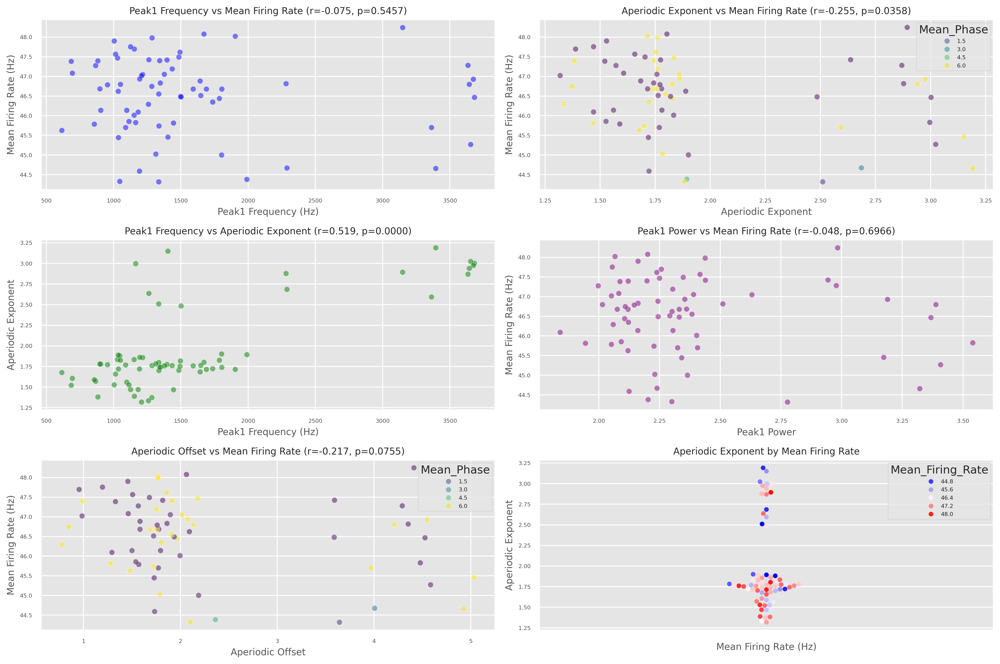

In [30]:
mean_rate = baseline_rates_per_neuronPC.mean(axis=1)
mean_rateBK = baseline_rates_per_neuronBK.mean(axis=1)
# foof_features['Mean_Firing_Rate'] = mean_rate

fig, axs = plt.subplots(3, 2, figsize=(15, 10), dpi=300)

# Mean Freq vs Peak Freq
pvalue1, r1 = corr_pvalue(foof_features['Peak1_Freq'], foof_features['Mean_Firing_Rate'])
sns.scatterplot(data=foof_features, x='Peak1_Freq', y='Mean_Firing_Rate', ax=axs[0, 0], color='blue', alpha=0.5)
axs[0, 0].set_title(f'Peak1 Frequency vs Mean Firing Rate (r={r1:.3f}, p={pvalue1:.4f})')
axs[0, 0].set_xlabel('Peak1 Frequency (Hz)')
axs[0, 0].set_ylabel('Mean Firing Rate (Hz)')

# Mean Freq vs Slope
pvalue2, r2 = corr_pvalue(foof_features['Aperiodic_Exponent'], foof_features['Mean_Firing_Rate'])
sns.scatterplot(data=foof_features, x='Aperiodic_Exponent', y='Mean_Firing_Rate', ax=axs[0, 1], color='red', alpha=0.5, hue='Mean_Phase', palette='viridis')
axs[0, 1].set_title(f'Aperiodic Exponent vs Mean Firing Rate (r={r2:.3f}, p={pvalue2:.4f})')
axs[0, 1].set_xlabel('Aperiodic Exponent')
axs[0, 1].set_ylabel('Mean Firing Rate (Hz)')

# Peak Freq vs Aperiodic Offset
pvalue3, r3 = corr_pvalue(foof_features['Peak1_Freq'], foof_features['Aperiodic_Exponent'])
sns.scatterplot(data=foof_features, x='Peak1_Freq', y='Aperiodic_Exponent', ax=axs[1, 0], color='green', alpha=0.5)
axs[1, 0].set_title(f'Peak1 Frequency vs Aperiodic Exponent (r={r3:.3f}, p={pvalue3:.4f})')
axs[1, 0].set_xlabel('Peak1 Frequency (Hz)')
axs[1, 0].set_ylabel('Aperiodic Exponent')   

# Power vs Mean Firing Rate
pvalue4, r4 = corr_pvalue(foof_features['Peak1_Power'], foof_features['Mean_Firing_Rate'])
sns.scatterplot(data=foof_features, x='Peak1_Power', y='Mean_Firing_Rate', ax=axs[1, 1], color='purple', alpha=0.5)
axs[1, 1].set_title(f'Peak1 Power vs Mean Firing Rate (r={r4:.3f}, p={pvalue4:.4f})')
axs[1, 1].set_xlabel('Peak1 Power')
axs[1, 1].set_ylabel('Mean Firing Rate (Hz)')

# Aperiodic Offset vs Mean Firing Rate colorcoded by Mean Phase
pvalue5, r5 = corr_pvalue(foof_features['Aperiodic_Offset'], foof_features['Mean_Firing_Rate'])
sns.scatterplot(data=foof_features, x='Aperiodic_Offset', y='Mean_Firing_Rate', ax=axs[2, 0], color='orange', alpha=0.5, hue='Mean_Phase', palette='viridis')
axs[2, 0].set_title(f'Aperiodic Offset vs Mean Firing Rate (r={r5:.3f}, p={pvalue5:.4f})')
axs[2, 0].set_xlabel('Aperiodic Offset')
axs[2, 0].set_ylabel('Mean Firing Rate (Hz)')

# Swarm plot of aperiodic exponent by firing rate
sns.swarmplot(data=foof_features, y='Aperiodic_Exponent', hue='Mean_Firing_Rate', palette='bwr')
axs[2, 1].set_title('Aperiodic Exponent by Mean Firing Rate')
axs[2, 1].set_xlabel('Mean Firing Rate (Hz)')
axs[2, 1].set_ylabel('Aperiodic Exponent')

plt.tight_layout()
plt.show()

In [31]:
foof_features

,Peak1_Freq,Peak1_Power,Peak1_Bandwidth,Aperiodic_Offset,Aperiodic_Exponent,Total_Energy_Entire_PSD,Mean_Phase,Std_Phase,Mean_Firing_Rate,Total_Energy
0,1785.805071,2.105720,29.001421,1.969041,1.827419,5.137805,6.153034,1.964513,46.443278,33.446594
1,2289.017874,2.239553,3000.000000,4.006054,2.686008,4.414709,2.361586,1.840048,44.673220,29.348993
2,1484.001709,2.347297,20.815239,1.681459,1.703779,5.170732,0.037555,2.000181,47.492694,31.811520
3,3682.193282,3.367403,1052.029096,4.526399,3.002476,4.431036,0.015829,1.955101,46.466525,24.607132
4,1670.165070,2.200632,38.820572,2.063714,1.803043,5.367068,0.003894,1.970182,48.077179,28.871596
...,...,...,...,...,...,...,...,...,...,...
63,1313.744783,2.230602,91.552181,1.789886,1.782917,4.641338,6.196567,1.877925,45.025239,41.705935
64,1113.263048,2.092245,23.591246,1.540691,1.526516,5.030434,0.177829,1.916673,45.855473,39.140461
65,1376.972842,2.389682,30.932987,1.897285,1.757581,4.311642,0.154700,2.010129,47.054330,63.789351
66,953.490913,2.146028,19.531250,1.761557,1.771607,3.347601,0.016787,2.029808,46.788656,62.264595


In [32]:
psd_no_aperiodic = psd_without_aperiodic(psd_pc, freqs_pc, foof_features)

Frequencies spacing in psd: 9.77 Hz
number of frequencies in the range 40-110 Hz: 7
Extracted frequencies in the range: [ 48.828125  58.59375   68.359375  78.125     87.890625  97.65625
 107.421875]
Shape of psd_masked: (68, 7)
Shape of psd_pc_energy: (68,)


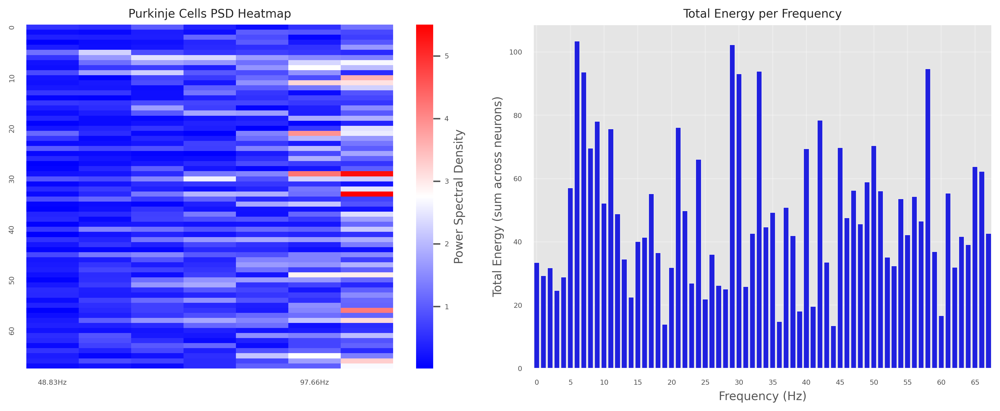

Frequency range: 48.8 - 107.4 Hz
Total energy across all frequencies: 3276.50


In [33]:
psd_pc_masked, freqs_mask = psd_mask(freqs_pc, psd_no_aperiodic, range_mask=(40, 110))

# Calculate total energy per neuron (integral across frequencies)
psd_pc_energy = np.trapezoid(psd_pc_masked.values, dx=freqs_pc[1] - freqs_pc[0], axis=1)

print(f"Shape of psd_pc_energy: {psd_pc_energy.shape}")
psd_pc_energy = pd.DataFrame(psd_pc_energy, columns=['Energy'])
extracted_freqs = freqs_pc[freqs_mask]

fig, ax = plt.subplots(1, 2, figsize=(12, 5), dpi=300)

# Left plot: PSD heatmap (neurons x frequencies)
ax[0].set_title('Purkinje Cells PSD Heatmap')
ax[0].set_xlabel('Frequency (Hz)')
ax[0].set_ylabel('Neurons')
sns.heatmap(psd_pc_masked, cmap='bwr', cbar_kws={'label': 'Power Spectral Density'}, 
            yticklabels=10, xticklabels=5, ax=ax[0])

# Right plot: Total energy per frequency
ax[1].set_title('Total Energy per Frequency')
ax[1].set_xlabel('Frequency (Hz)')
ax[1].set_ylabel('Total Energy (sum across neurons)')
sns.barplot(x=psd_pc_energy.index, y=psd_pc_energy['Energy'], color='blue', ax=ax[1])
ax[1].set_xticks(np.arange(0, len(psd_pc_energy.index), 5))
ax[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print some statistics
print(f"Frequency range: {extracted_freqs[0]:.1f} - {extracted_freqs[-1]:.1f} Hz")
print(f"Total energy across all frequencies: {np.sum(psd_pc_energy['Energy']):.2f}")

In [34]:
# psd_pc_masked = pd.DataFrame(psd_pc_masked)
# psd_pc_masked.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/psdPC_baseline12.csv', index=False)

In [35]:
# foof_features['Total_Energy'] = psd_pc_energy['Energy'].values

Text(0, 0.5, 'Mean Firing Rate (Hz)')

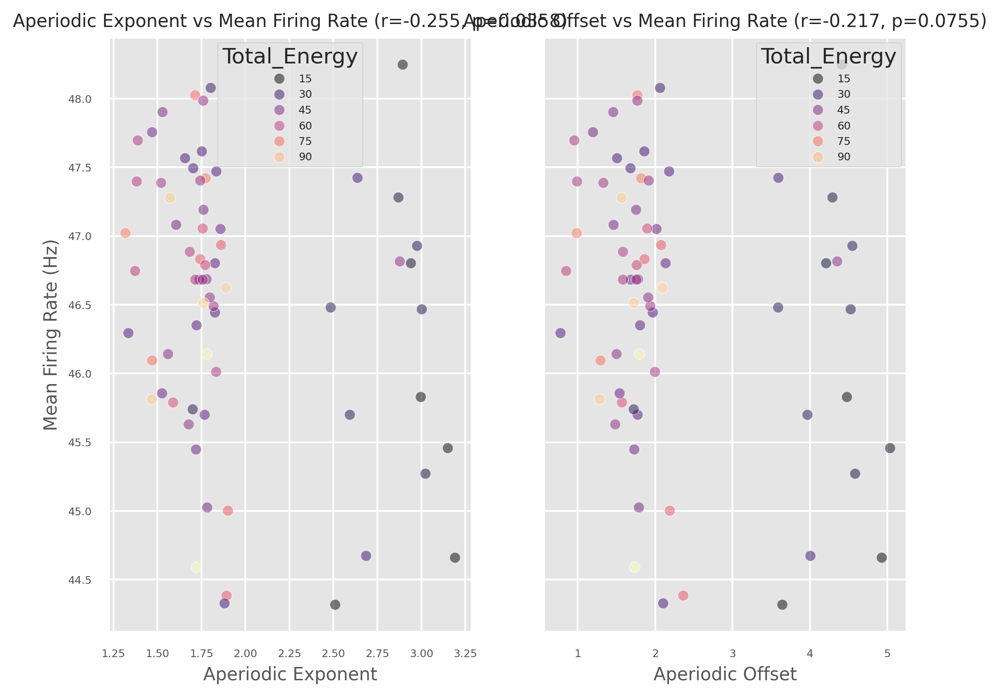

In [36]:
fig, axs = plt.subplots(1, 2, figsize=(8, 6), sharey=True, dpi=300)
# Mean Firing Rate vs Aperiodic exponent colorcoded by total energy
pvalue1, r1 = corr_pvalue(foof_features['Aperiodic_Exponent'], foof_features['Mean_Firing_Rate'])
sns.scatterplot(data=foof_features, x='Aperiodic_Exponent', y='Mean_Firing_Rate', ax=axs[0], alpha=0.5, hue='Total_Energy', palette='magma')
axs[0].set_title(f'Aperiodic Exponent vs Mean Firing Rate (r={r1:.3f}, p={pvalue1:.4f})')
axs[0].set_xlabel('Aperiodic Exponent')
axs[0].set_ylabel('Mean Firing Rate (Hz)')

# Mean Firing Rate vs Aperiodic Offset colorcoded by total energy
pvalue2, r2 = corr_pvalue(foof_features['Aperiodic_Offset'], foof_features['Mean_Firing_Rate'])
sns.scatterplot(data=foof_features, x='Aperiodic_Offset', y='Mean_Firing_Rate', ax=axs[1], alpha=0.5, hue='Total_Energy', palette='magma')
axs[1].set_title(f'Aperiodic Offset vs Mean Firing Rate (r={r2:.3f}, p={pvalue2:.4f})')
axs[1].set_xlabel('Aperiodic Offset')
axs[1].set_ylabel('Mean Firing Rate (Hz)')

In [37]:
# foof_features.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/foof_features_baseline12.csv', index=False)

In [44]:
results_corr = MLI_pc_exponent_analysis(foof_features, baseline_rates_per_neuronMLI, baseline_rates_per_neuronPC, labels_baseline)

Shape of population MLI activity: (1882,)
Shape of population PC activity: (1882,)
Shape of mean PC rates: (68,)
Population MLI-PC correlation: 0.561 and p-value: 0.0000
PC firing rate vs aperiodic exponent correlation: -0.255 and p-value: 0.0358
PC-MLI correlation strength vs aperiodic exponent: -0.201, p:0.0994
ON neurons - PC-MLI corr vs aperiodic exp: -0.194, p:0.2065
OFF neurons - PC-MLI corr vs aperiodic exp: -0.140, p:0.5141


In [45]:
results_corr['Cluster'] = labels_baseline

In [46]:
results_corr.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/correlation_results_baseline12.csv', index=False)

Overall correlation between PC-basket strength and aperiodic exponent: -0.201 (p=0.0994)


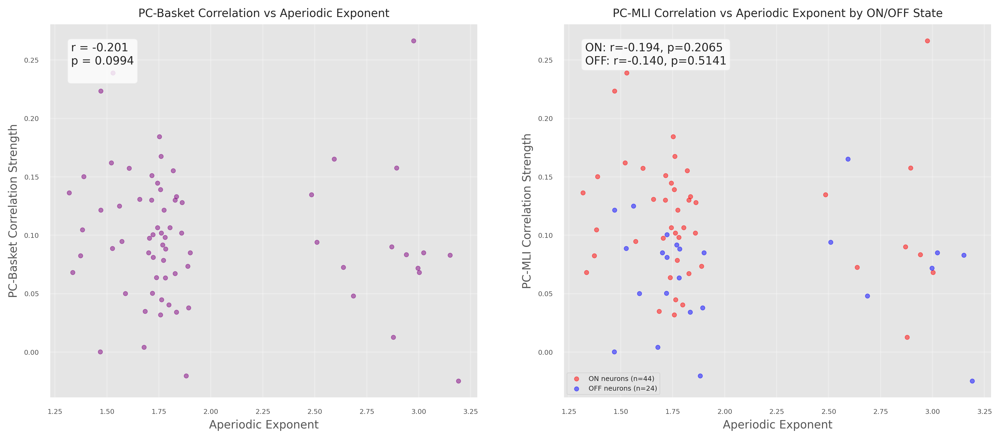

In [47]:
plot_pc_MLI_vs_exponent(results_corr, labels_baseline)

Shape of centered ratesPC: (68, 1882)
Shape of mean_BK: (1882,)
Estimated Mutual Information: [0.         0.00155044 0.01357945 0.         0.00328019 0.
 0.         0.         0.         0.         0.02464448 0.0127452
 0.00735448 0.01952334 0.0074262  0.0324532  0.0263324  0.
 0.0233197  0.00996482 0.01124048 0.         0.01956712 0.
 0.00507805 0.         0.01269334 0.016861   0.         0.
 0.         0.03207266 0.01877893 0.         0.         0.01098249
 0.02013942 0.01873046 0.         0.         0.         0.
 0.         0.02778125 0.01394725 0.01409001 0.         0.
 0.0213411  0.         0.01208775 0.         0.00070132 0.00582462
 0.         0.0163683  0.00315256 0.         0.0364874  0.
 0.03368919 0.00480369 0.02265827 0.01905541 0.00077581 0.03587007
 0.         0.        ]


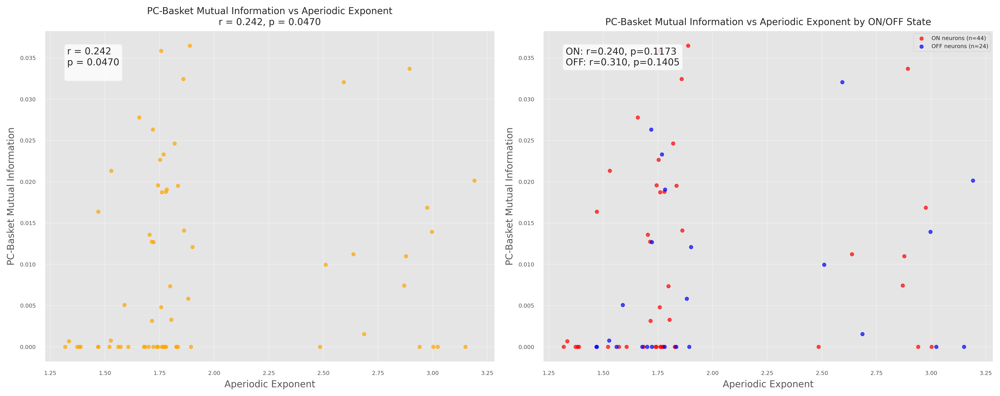

Overall correlation between PC-basket MI and aperiodic exponent: 0.242 (p=0.0470)


In [42]:
est_MI = mutual_info(baseline_rates_per_neuronPC, baseline_rates_per_neuronBK)
plot_pc_basketMI_vs_exponent(est_MI, foof_features, labels_baseline)